# 場所概念の可視化
training dataのうち発話データがある場所の可視化  
学習した場所概念の平均と分散を表示


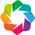

In [1]:
import glob
import os 
import shutil
import numpy as np
import pandas as pd
from operator import mul, add
from matplotlib import pyplot as plt
import IPython
import holoviews as hv
import re
hv.extension('bokeh')
%matplotlib inline

### 学習データの可視化

In [5]:
spatial_data_paht = "../data/trial/"
spatial_result_paht = "../result/trial/"

In [6]:
convert = lambda text: int(text) if text.isdigit() else text
alphanum_key = lambda key: [ convert(c) for c in re.split('([0-9]+)', key) ]
# file.sort(key = alphanum_key)

position_data_path = glob.glob(os.path.join(spatial_data_paht, "position_data/*"))
position_data_path.sort(key = alphanum_key)

In [7]:
position_list = [np.array([0,0])]
word_list = []
for i,data in enumerate(position_data_path):
    tmp_position = pd.read_csv(data ,header=None,delimiter=" ").iloc[0].values
    try:
        word_path = os.path.join(spatial_data_paht, "word/{}.txt".format(i))
        tmp_word = str(np.loadtxt(word_path,dtype=str))
    except:
        tmp_word = "non"
    position_list.append(tmp_position)
    word_list.append(tmp_word)
position_list = np.array(position_list)

In [8]:
position_name = pd.concat([ pd.DataFrame(position_list), pd.DataFrame(word_list) ],axis=1 )
position_name.columns = ["x","y","word"]
space_name = np.loadtxt("../data/trial/space_name.txt",dtype=str)
space_name = np.append(["non"],space_name)
position_name["data_id"] = range(len(position_name))
graph = [hv.Points(position_name[position_name.word==space],label=space) for space in space_name]

In [9]:
%%output size =　100
%%opts Points (color=Cycle('Category20') size=12 line_color="k" alpha=0.8) [tools=['hover'] ]
reduce(mul,graph)

:Overlay
   .Points.Non                                                          :Points   [x,y]   (word,data_id)
   .Points.Cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e        :Points   [x,y]   (word,data_id)
   .Points.Cjk_unified_ideograph_8a73_cjk_unified_ideograph_7d30        :Points   [x,y]   (word,data_id)
   .Points.Cjk_unified_ideograph_5bdd_cjk_unified_ideograph_5ba4        :Points   [x,y]   (word,data_id)
   .Points.Katakana_ki_katakana_tu_katakana_ti_katakana_n               :Points   [x,y]   (word,data_id)
   .Points.Katakana_do_katakana_a_cjk_unified_ideograph_524d            :Points   [x,y]   (word,data_id)
   .Points.Cjk_unified_ideograph_771f_cjk_unified_ideograph_5b9f        :Points   [x,y]   (word,data_id)
   .Points.Cjk_unified_ideograph_89aa_cjk_unified_ideograph_5b50        :Points   [x,y]   (word,data_id)
   .Points.Cjk_unified_ideograph_98a8_cjk_unified_ideograph_5442        :Points   [x,y]   (word,data_id)
   .Points.Katakana_pu_katakana_ro                                      :Points   [x,y]   (word,data_id)
   .Points.Katakana_hu_katakana_e_katakana_i_katakana_su                :Points   [x,y]   (word,data_id)
   .Points.Katakana_su_katakana_i_katakana_su                           :Points   [x,y]   (word,data_id)
   .Points.Katakana_hu_katakana_o_katakana_a_cjk_unified_ideograph_524d :Points   [x,y]   (word,data_id)
   .Points.Cjk_unified_ideograph_9ed2                                   :Points   [x,y]   (word,data_id)

### 学習した場所概念を学習データにオーバーレイして表示

In [15]:
def rad2deg(rad):
    return rad * 180.0 / np.pi

tmp_pose_back = None
def make_graph():
    spatial_result_paht = "../result/trial/"

    convert = lambda text: int(text) if text.isdigit() else text
    alphanum_key = lambda key: [ convert(c) for c in re.split('([0-9]+)', key) ]
    tmp_data_path = glob.glob(os.path.join(spatial_result_paht, "word/*"))
    tmp_data_path.sort(key = alphanum_key)

    space_name_pd = pd.read_csv("../data/trial/space_name.txt",header=None)
    space_name_pd.columns = ["word"]

    class_list = []
    for i in range(len(tmp_data_path)):
        value = pd.read_csv(tmp_data_path[i],header=None).iloc[0].values[0]
        if 0.25 != value:
            class_list.append(i)

    tmp_pose = position_name.iloc[0:1,:].copy()
    graph_2 = []
    for i in class_list:
        tmp_pose = position_name.iloc[0:1,:].copy()
        word = space_name_pd.iloc[np.argmax(pd.read_csv(tmp_data_path[i],header=None).values)][0]
        tmp_pose.word = "correct" + space_name_pd.iloc[np.argmax(pd.read_csv(tmp_data_path[i],header=None).values)][0]


        x = np.loadtxt("../result/trial/mu/gauss_mu{0}.csv".format(i),dtype=np.float64)[0]
        y = np.loadtxt("../result/trial/mu/gauss_mu{0}.csv".format(i),dtype=np.float64)[1]

        vx = np.loadtxt("../result/trial/sigma/gauss_sgima{0}.csv".format(i),dtype=np.float64)[0][0]
        vy = np.loadtxt("../result/trial/sigma/gauss_sgima{0}.csv".format(i),dtype=np.float64)[1][1] 

        cv = np.loadtxt("../result/trial/sigma/gauss_sgima{0}.csv".format(i),dtype=np.float64)[1][0]

        tmp_pose.x = x
        tmp_pose.y = y
        scale = 2
        vx *= scale
        vy *= scale 
        tmp_pose["vx"] = vx
        tmp_pose["vy"] = vy 
        orientation = rad2deg(np.arctan2(cv, vx))
        orientation = np.arctan2(cv, vx)

        tmp_pose.data_id = i
        graph_2.append(hv.Points(tmp_pose,label="concept {}".format(word)))
        graph_2.append(hv.Ellipse(x,y,(vx,vy),orientation=orientation))
    return graph_2

In [16]:
%%output size=100
%%opts Ellipse (line_width=3)
%%opts Points (color=Cycle('Category20') size=12 line_color="k" alpha=0.8) [tools=['hover'] legend_position="top" ]

result_graph = make_graph()
# reduce(add,[(reduce(mul,graph) * reduce(mul,result_graph[i])).relabel(str(i)) for i in range(NUM)]).cols(3)

In [18]:
reduce(mul,result_graph)

:Overlay
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.I        :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.I                                                                     :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.II       :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.II                                                                    :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.III      :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.III                                                                   :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.IV       :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.IV                                                                    :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.V        :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.V                                                                     :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.VI       :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.VI                                                                    :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.VII      :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.VII                                                                   :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.VIII     :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.VIII                                                                  :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.IX       :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.IX                                                                    :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.X        :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.X                                                                     :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.XI       :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.XI                                                                    :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.XII      :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.XII                                                                   :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.XIII     :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.XIII                                                                  :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.XIV      :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.XIV                                                                   :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.XV       :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.XV                                                                    :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.XVI      :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.XVI                                                                   :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.XVII     :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.XVII                                                                  :Ellipse   [x,y]
   .Points.Concept_cjk_unified_ideograph_66f8_cjk_unified_ideograph_658e.XVIII    :Points   [x,y]   (word,data_id,vx,vy)
   .Ellipse.XVIII                                                                 :Ellipse   [x,y]
   .Points.Concept_cjk_unified_

### 場所概念の可視化 @ map
作成中

In [20]:
import cv2

In [23]:
im = cv2.imread("../map/map.pgm")

In [24]:
hv.Image(im)

:Image   [x,y]   (z)